#  <center>Modelado de Tópicos</center>

* María Alejandra Arango González <maaarangogo@unal.edu.co>
* Cristian Gómez Alvarez <crgomezal@unal.edu.co>
* Juan Camilo Cuartas Montoya <juccuartasmo@unal.edu.co>

# Modelado de Tópicos


<img src="folder.png" width="100px" align="left" style="margin:0px 30px 0px 0px"> Es una técnica para tratar documentos que no tienen alguna categorización, y asume que cada documento es una mezcla aleatoria de categorías o tópicos.

Un tópico en el contexto de modelado de tópicos es una distribución de probabilidades de palabras para un conjunto, e indica la probabilidad que una palabra aparezca en un documento sobre un tópico en particular.

## Utilidad
<img src="organization.png" width="40px" align="left" style="margin:0px 20px 0px 0px"> Puede ser usado para clasificar documentos similares, mejorar la indexación de texto y los métodos de recuperación de la información y encontrar patrones repetitivos que pueden derivarse de la estructura del texto.


## LDA
Hay dos métodos de aprendizaje automático con las iniciales LDA:
    1. Asignación de Dirichlet latente, que es un método de modelado
    2. Análisis discriminante lineal, que es un método de clasificación
    
No tienen relación, excepto por el hecho de que las iniciales LDA pueden referirse a cualquiera.

LDA pertenece a una clase de modelos que son llamados modelos generativos ya que tienen una especie de fábula, 
que explica cómo se generaron los datos. Esta historia es generativa a una simplificación de la realidad, por supuesto,
para hacer más fácil el aprendizaje de la máquina. En primer lugar crear temas mediante la asignación de los pesos 
de probabilidad a las palabras. cada tema será asignar diferentes pesos a diferentes palabras.

El método usado para ajustar los modelos es el VEM (Variational Expectation-Maximization). Tanto R como Python utilizan este método en sus algoritmos.

### Especificación del modelo

Se tiene un número de tópicos $k$ fijado a-priori. El modelo LDA asume que para un documento $w=(w_1,...,w_N)$ de un corpus $D$ que contiene $N$ palabras de un vocabulario con $V$ términos, $w_i \in \{1,...,V\}$ para todo $i=1,...,N$.

<img src="dirichlet.png" width="300px" align="right"> El modelo generativo consiste en los siguientes 3 pasos:
1. El término de distribución $\beta$ es determinado para cada tópico por:$\beta \sim Dirichlet(\delta)$
2. Las proporciones $\theta$ del tópico de distibución para el documento $w$ son determinadas por: $\theta \sim Dirichlet(\alpha)$
3. Para cada una de la $N$ palabras $w_i$:
    + Escoja un tópico $z_i \sim Multinomial(\theta)$
    + Escoja una palabra $w_i$ desde una distribución de probabilidad multinomial condicionada en el tópico $z_i: p(w_i|z_i , \beta)$

$\beta$ es el término de distribución de tópicos y contiene la probabilidad de que una palabra ocurra en un tópico dado.

### Estimación

<p>Para estimar el modelo LDA se realiza el proceso de estimación de máxima verosimilitud (MLE - Maximum Likelihood Estimation). La suma del logaritmo de las similitudes de todos los documentos se maximiza con respecto a los parámetros $\alpha$ y $\beta$. En este caso $\beta$ es el parámetro de interés. Para un documento $w \in D$, la estimación está dada por:<p>
<p style="text-align:center"><img src="Selección_024.png" width="450px"></p>

## Ejemplo
Asignar alta probabilidad de que la palabra "variable" y una baja probabilidad a la palabra
"Ebrio". 
Cuando se desea generar un nuevo documento, primero elegimos los temas que
utilizará y luego mezclar palabras de estos temas.

Por ejemplo, supongamos que tenemos sólo tres temas que tratan sobre los libros:

• Aprendizaje automático
• Python
• Horneando

Para cada tema, tenemos una lista de palabras asociadas a ella. Este libro será una
mezcla de los dos primeros temas, tal vez 50 por ciento cada uno. La mezcla no necesita
a ser igual, sino que también puede ser una fracción de 70/30. 

En este modelo, el orden de las palabras no importa. Se trata de una bolsa de palabras, porque el hecho de saber que las palabras se utiliza en un documento y sus frecuencias son suficientes para tomar decisiones de aprendizaje automático.

En el mundo real, no sabemos lo que son los temas. Nuestra tarea es tomar una colección de texto y aplicar ingeniería inversa a esta fábula con el fin de descubrir qué temas están fuera, allí y al mismo tiempo averiguar qué temas utiliza cada documento.



## Python

Importar corpora y models

In [3]:
from gensim import corpora, models
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

Cargar los archivos de datos en la variable corpus. La variable almacena todos los documentos de texto en una forma fácil de procesar

In [8]:
corpus = corpora.BleiCorpus('datos/ap.dat', 'datos/vocab.txt')

Se crea un modelo de temas usando corpus cómo base de información. Información sobre LdaModel se puede encontrar en https://radimrehurek.com/gensim/models/ldamodel.html

La llamada de esta función inferirá qué temas están presentes en el corpus (colección de artículos o escritos sobre un tema particular)

In [9]:
modeloTemas = models.ldamodel.LdaModel(corpus, num_topics=100, id2word=corpus.id2word)

El modelo puede explorarse de diferentes formas. Utilizando model[doc] se puede ver la lista de temas a las que se refiere un documento.
Se visualizan como el Id del tema y la probabilidad que tiene asignada (ningún tema tiene probabilidad 0 pero por aproximación, algunos quedan con 0 y no se muestran)

In [7]:
len(corpus)    #Número de documentos en el corpus

2246

In [62]:
temas = [modeloTemas[c] for c in corpus]
print(temas[0])

[(3, 0.40388559040602212), (11, 0.026856075669584645), (15, 0.18338489661166033), (37, 0.035874296885641241), (41, 0.014952215114180798), (52, 0.052545514027481303), (56, 0.036529919702285966), (75, 0.032924293568477161), (88, 0.012712023601589593), (93, 0.1364492986141754), (96, 0.03361039933981886), (99, 0.010631335443377405)]


In [63]:
# Otra forma de visualizar los temas del primer documento
doc=corpus.docbyoffset(0)
temasDoc=modeloTemas[doc]
print(temasDoc)

[(3, 0.40587755061231656), (11, 0.026035214409023684), (15, 0.18302869747223535), (37, 0.035706738452867551), (41, 0.016004722127058901), (52, 0.05498895089327193), (56, 0.036839851200689562), (59, 0.013409955003075041), (75, 0.037197561873838728), (88, 0.012626566575326981), (93, 0.1334255691576286), (96, 0.034560797157502654)]


En el histograma del número de temas usados en el documento, puede visualizarse mejor este hecho

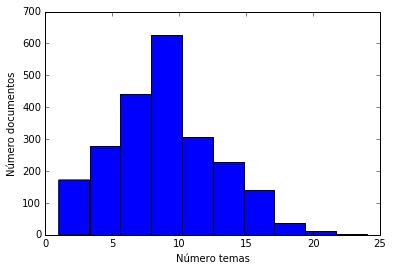

In [30]:
numTemas = [len(modeloTemas[doc]) for doc in corpus]    #Formar un array con los números de temas de cada documento
plt.hist(numTemas)
plt.ylabel('Número documentos')
plt.xlabel('Número temas')
plt.show()

El parámetro alpha del constructor de LdaModel define cómo se distribuyen cuántos temas pueden tratarse por documento, tiene un valor entre 0 y 1 y por defecto tiene el valor de 1/num_topics

In [31]:
modeloTemasAlpha=models.ldamodel.LdaModel(corpus, num_topics=100, id2word=corpus.id2word, alpha=1)

Al hacer el histograma nuevamente, se encontrará que hay una distribución de temas por documento diferente

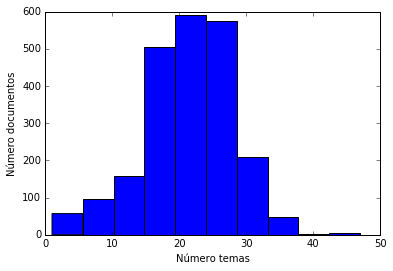

In [34]:
numTemasAlpha = [len(modeloTemasAlpha[doc]) for doc in corpus]            #Formar un array con los números de temas de cada documento
plt.hist(numTemasAlpha)
plt.ylabel('Número documentos')
plt.xlabel('Número temas')
plt.show()

Los temas son distribuciones multinomiales que se hacen sobre las palabras (cada palabra tiene una probabilidad para cada tema y aquellas palabras con mayor probabilidad pertenencen al tema).

Mostrar las palabras que conforman el primer tema:

In [64]:
palabras=modeloTemas.show_topic(3, 64)
print(palabras)

[('ruby', 0.051663868980996855), ('mecham', 0.024315685363037666), ('watkins', 0.018403418716222537), ('gun', 0.011551356149153131), ('milstead', 0.010639651971742128), ('birthday', 0.009477753956222747), ('mayer', 0.0081678926218770216), ('grandfather', 0.0070423882633605678), ('pastor', 0.006762924098240585), ('trial', 0.0063331443157548508), ('baptist', 0.0062086375790862272), ('mechams', 0.0060006571594056757), ('years', 0.0058340813557953468), ('state', 0.0049397930354346878), ('communitys', 0.0044937651734415903), ('disneys', 0.0040767162895099475), ('president', 0.0039931339374073204), ('threat', 0.003904849134783376), ('monday', 0.0038203664222758072), ('subway', 0.0038000708406188523), ('mouse', 0.003727742668668804), ('nephew', 0.0037148273009717249), ('cartoon', 0.0036918864889538996), ('default', 0.0036823737293599479), ('two', 0.0036372023588885152), ('cbs', 0.003541191610819179), ('shores', 0.0034311915275994326), ('yearold', 0.0034099842846692695), ('senators', 0.0032996

#### Comparación de documentos por temas

La clasificación de documentos por temas es un paso intermedio para otro objetivo mayor. Hasta esta parte tenemos un estimado de los temas por los que está compuesto un documento, lo que nos permite comparar documentos en el espacio de temas. El objetivo entonces es pasar de una comparación palabra por palabra a identificar documentos similares determinando si tratan sobre los mismos temas.

Se generan objetos de NumPy con los temas de todos los documentos en el corpus para calcular las distancias entre cada documento

In [65]:
from gensim import matutils
topics = matutils.corpus2dense(modeloTemas[corpus], num_terms=modeloTemas.num_topics)

topics es una matriz y podemos usar la función pdist de SciPy para calcular las distancias por parejas. Con un llamado a la función, se están calculando todos los valores de sum((topics[ti] – topics[tj])**2):

In [66]:
from scipy.spatial import distance
pairwise = distance.squareform(distance.pdist(topics))

Ahora se ajusta un poco la matriz de distancias modificando los elementos e la diagonal para que sean más grandes que la distancia más grande. Sin este ajuste, la función a continuación siempre retornaría el mismo documento como el más cercano

In [67]:
largest = pairwise.max()
for ti in range(len(topics)):
	pairwise[ti,ti] = largest+1

Por último construímos un clasificador de temas por proximidad (distancia más baja). Documentación de NumPy.argmin(): http://docs.scipy.org/doc/numpy-1.10.1/reference/generated/numpy.argmin.html

In [73]:
def closest_to(doc_id):
    closest=pairwise[doc_id].argmin()
    return closest
    #return [topics[doc_id], topics[closest]]

Obtener el documento más parecido a aquel con ID 1:

In [75]:
closest_to(2)

92

## R

Importa la librería 'topicmodels'

In [3]:
library(topicmodels)

Carga la base de datos Associate Press

In [4]:
data("AssociatedPress", package = "topicmodels")

Se crea el modelo de temas utilizando la función LDA

In [5]:
lda <- LDA(AssociatedPress, k = 100)

Número de documentos

In [10]:
AssociatedPress$nrow

[1] 2246

Temas a los que pertenece cada documento

In [12]:
topics(lda)

[1]  60  45  60  93  65  40  23  78  86  18  55  32  78  22  66  32  85  78
  [19]  62  44  63  34  33   1  68  54   3  24  38  64  66  65   5  16  86  94
  [37]  65  20  22  71   3  68  55  52  84  91  46  76  81   3  30  34  53  63
  [55]  61   6  76  37  88  34  46  33  66  60  77  13  48   2  52  82  49  60
  [73]  97  61  14  51  69  78  64  76  20  31  42  63  38  56  66   4  66  76
  [91]  79  92  73  74  91  70  80  70  48  23  54  52   3  25  13  48  87  24
 [109]  75  82   1  93  28  71  38   3   4  22  74  66  43  34  39  84  10  34
 [127]   4  39  27  80   5   3  90  73  94  36  69  12  85  35  43  16   2  11
 [145]  55  88  74   5   3  83   1  12  69  62  27  58  70  45  12  57  19  24
 [163]  88  17  46  51  84  96  61  63  98  76  39  92   5  26  60  36  42  70
 [181]  30  61  36  71  67  62  34  11  36  38  87  56  96  37  42  78  56  93
 [199]  18  11  60  92  46  86  34  44  93  70  12  43  70  52  37  60  56  57
 [217]  88  37  66  25  97  49  87   3 100  15  22  18  24  83  89  60  69  17
 [235]  15  36  78  46  61  34  49  46  30  49  75  42  29  10  46  95  91  60
 [253]  57  33  40  30  12  78   7  67  83  42  62  95  49  13  88  72  34   3
 [271]  86  27  35   5  26  12   9  54  87  50  14  78  70   9  91  36  41  76
 [289]  32  45  86  95  34   5  53  18  50   3   7  34  57  77  88  43  11  59
 [307]  41  41  78  73  68  65  15  29  67  77  16  48  92  39   6  83  41  13
 [325]  24  31  39  85  41  87  22  86  65  31   9  47 100  29   6  33  91  32
 [343]  89  56  17   2   1  90   5  30  79  26  86  85  18   8  78   5  12  68
 [361]  43  19  32  69  16  86  27  59  72  66  91  87  98  10  46  62  13   3
 [379]  52   7  81  54  55  62  44   6  36  72  87  21   5   4   3  40  78  91
 [397]  31  13  15  77  19  58  85  18  21  89  91  20  26  48  39  42  28  73
 [415]  81  35  66  56  96  62  53  39  96  88  26  88  31  57  90  99  46  66
 [433]  41  66  59   4  78  20  73   6  63  23  84  22  39  47  11  13  86  99
 [451]  28  22  92  44  49  50   3  31  34  48  97  54  60   1  65  95   4   6
 [469]  76  24  21  49   4  88  46  17  39  44  48  51  49  66  11  10  37  21
 [487]  72  26  46  85  27  11  81  72  28  93  79  31  59  56  34  41   5  45
 [505]  40  96  26 100  25  22  67  93  18   3  28  72  29  71  28   6  90  85
 [523]  12  98  46  49  34 100  53  34  89  72  41  74  20  29  46  74 100  57
 [541]  13  93  20  34  35  38   6  30  34  64  61  84   8  33  29  41   9  42
 [559]   3  86  46  33  30  80  57  73   5  70   8  12  87  88  12  43   6   3
 [577]   1  82  19  89  91  85  81  98  43  80  77  64  30  17  35  73   4  46
 [595]   3  82  87  83  57  73  49  88  16  26  55   9  58  83  94  82  24  49
 [613]   8  63  12  52  11  88  74  33 100  27  95  49  65  20  89  98   1  56
 [631]  39  44  50  34  39  34  26  70  44  15  15   5  34  57  47  74   9  96
 [649]  99  19  98  33  78  68  23  12  29  40  31  18  78  12  42   3  63   2
 [667]  54  20  56  70  78  72  34  77   6  49  61   8  81   9   5   6  78  69
 [685]  18  89  47  75  57   6  29  66  78  35  72  74  62   9  34  93  33  17
 [703]  27   6  75  24  20  24  90  67  18  73  57  66  82  34  41  63   6  34
 [721]  55  41  37  31   7   2  87  40  51  62  88   4  78  84  20  97  49  95
 [739]  32  15  34  32  22  41  31  66  18  49  25  15  53  81   3  84  10  91
 [757]  14  34  17  33 100  62  57  93  34  79  22  34  34  85  98  69  68  35
 [775]  99  40  58  11  33  84  21  91  98  37   1  76  37  18  50  80  46  82
 [793]  34  12  82  47  87  94  76  49  88  63  80  18  71  16  11  39  74  46
 [811]  93  65  39  36  28  88  79  15  59  25  66  26  78   4   9   5  85  85
 [829]  68  61  40   3   6  45  70  23  24  25  96  60  10  51  59  37  34  34
 [847]   2  31  62  46   3  92  66  97  75  18  77  55  42  55  70  50  76   1
 [865]  98  29  67  48  48  18  94  84  12  83  20  37  40  54  50  15  17  38
 [883]  66  30  45  66  83  49  81  70  78  13  31  73  60  56  39  58  66  67
 [901]  14  41  61   2  28  92   1  11  79  84   8  3

Histograma

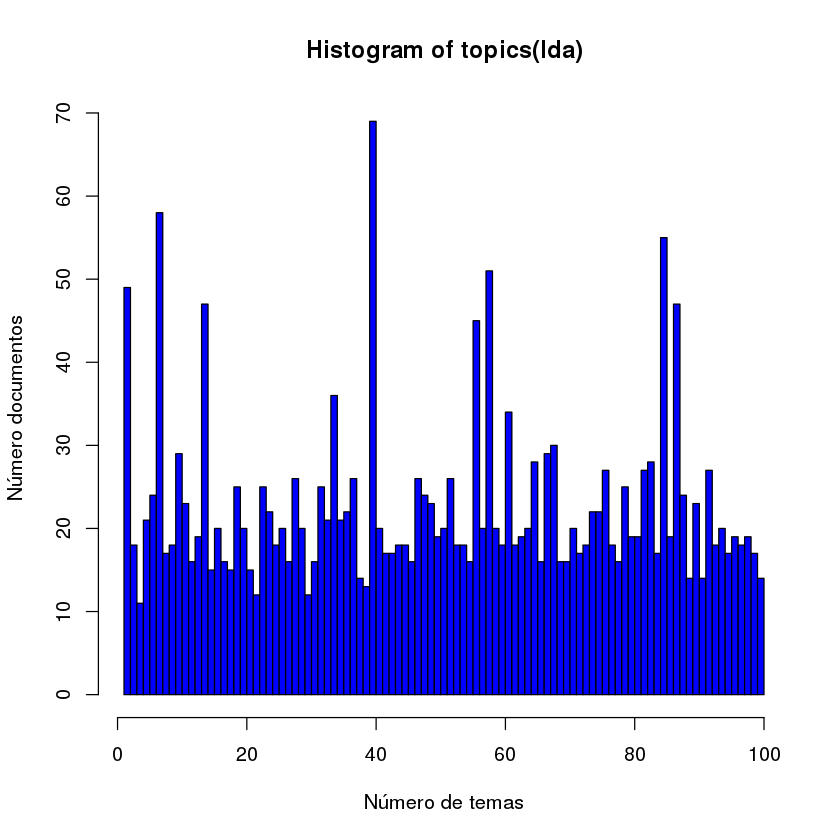

In [12]:
hist(topics(lda), breaks=100, xlab="Número de temas", ylab="Número documentos",col="blue")

En general, el alpha del modelo está definido por 1 dividido la cantidad de tópicos. Es posible cambiarlo como parámetro así: 

In [ ]:
lda2 <- LDA(AssociatedPress, control = list(alpha = 1), k = 100)

In [13]:
hist(topics(lda2),breaks=100, xlab="Número de temas", ylab="Número documentos",col="blue")

ERROR: Error in topics(lda2): error in evaluating the argument 'x' in selecting a method for function 'topics': Error: objeto 'lda2' no encontrado



Imprimir los tópicos

In [17]:
terms(lda)

Topic 1      Topic 2      Topic 3      Topic 4      Topic 5      Topic 6 
 "sinhalese"     "budget"     "soviet"    "shuttle"     "killed"     "soviet" 
     Topic 7      Topic 8      Topic 9     Topic 10     Topic 11     Topic 12 
      "news"        "say"          "i"        "new"     "dollar"     "police" 
    Topic 13     Topic 14     Topic 15     Topic 16     Topic 17     Topic 18 
    "people"    "rangoon"    "billion"      "court"      "state"      "party" 
    Topic 19     Topic 20     Topic 21     Topic 22     Topic 23     Topic 24 
       "oil"       "pope"    "futures"       "iraq"        "new"      "japan" 
    Topic 25     Topic 26     Topic 27     Topic 28     Topic 29     Topic 30 
    "soviet"      "labor"        "tax"       "bill"    "jackson"      "south" 
    Topic 31     Topic 32     Topic 33     Topic 34     Topic 35     Topic 36 
     "court"     "united"     "beirut"     "market"    "workers"    "germany" 
    Topic 37     Topic 38     Topic 39     Topic 40     Topic 41     Topic 42 
     "china"     "walesa"      "plane"          "i"       "drug"  "president" 
    Topic 43     Topic 44     Topic 45     Topic 46     Topic 47     Topic 48 
  "homeless"      "venus"      "meese"    "company"      "trade"       "fair" 
    Topic 49     Topic 50     Topic 51     Topic 52     Topic 53     Topic 54 
    "people"      "state"        "aid"     "school"    "bentsen"          "i" 
    Topic 55     Topic 56     Topic 57     Topic 58     Topic 59     Topic 60 
      "east"   "military"     "prison"    "percent"     "mecham"          "i" 
    Topic 61     Topic 62     Topic 63     Topic 64     Topic 65     Topic 66 
      "wine"    "million"          "i"   "computer"          "i"    "percent" 
    Topic 67     Topic 68     Topic 69     Topic 70     Topic 71     Topic 72 
    "people"       "bank"        "mrs"      "union"       "cars"       "aids" 
    Topic 73     Topic 74     Topic 75     Topic 76     Topic 77     Topic 78 
   "eastern"        "aid"          "i"   "congress"      "sales"       "bush" 
    Topic 79     Topic 80     Topic 81     Topic 82     Topic 83     Topic 84 
   "million"      "south"        "new"     "people"      "judge"      "quake" 
    Topic 85     Topic 86     Topic 87     Topic 88     Topic 89     Topic 90 
         "i"       "fire"  "officials" "government"    "million"        "new" 
    Topic 91     Topic 92     Topic 93     Topic 94     Topic 95     Topic 96 
       "air"    "percent"  "president"      "baker"    "keating"        "new" 
    Topic 97     Topic 98     Topic 99    Topic 100 
     "women"     "israel"        "new"          "i"

#### Comparación de documentos por temas

En Python es posible clasificar un tema encontrando el documento al que más se parece. La librería 'topicmodels' en R permite aplicar el modelo a un nuevo documento así:

In [8]:
lda_inf <- posterior(lda, AssociatedPress[2246,])
lda_inf

ERROR: Error in sprintf(wrap, header, body): 'fmt' length exceeds maximal format length 8192


,aaron,abandon,abandoned,abandoning,abbott,abboud,abc,abcs,abctvs,abdomen,,zero,zieman,ziemet,zimbabwe,zinoviev,zone,zones,zoo,zubal,zurich
1,3.72007597602084e-44,7.22007256612559e-55,1.16866639135478e-30,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,⋯,3.72007597602084e-44,3.72007597602084e-44,2.96847799543385e-111,0.00184536886870844,3.72007597602084e-44,4.95279332238233e-45,5.58319166170144e-298,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44
2,3.72007597602084e-44,3.72007597602084e-44,2.83541716473081e-77,3.67141065942796e-299,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,⋯,3.72007597602084e-44,3.72007597602084e-44,2.69781607276586e-111,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,7.47088142641953e-111,3.72007597602084e-44
3,4.29699867312683e-297,3.88515038219214e-297,4.53852093676733e-296,3.72007597602084e-44,0.000718475148399647,3.72007597602084e-44,3.84111700981579e-297,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,⋯,2.36938052704319e-297,3.72007597602084e-44,5.0252653839158e-111,3.72007597602084e-44,3.72007597602084e-44,7.46411158991665e-297,4.61425702220969e-297,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44
4,6.39215752986713e-297,5.77949754321316e-297,0.000397612840496634,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,5.71399408939552e-297,1.06424685031723e-297,3.72007597602084e-44,0.000397612838128546,⋯,3.5246586585952e-297,3.72007597602084e-44,5.56208533575645e-111,3.72007597602084e-44,3.72007597602084e-44,1.11035121815362e-296,6.86410679081389e-297,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44
5,2.84656359298642e-21,3.72007597602084e-44,1.03397636860861e-296,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,1.71792482030422e-109,3.72007597602084e-44,3.72007597602084e-44,0.00024746874288275,⋯,3.72007597602084e-44,3.72007597602084e-44,3.46176515937038e-111,3.72007597602084e-44,3.72007597602084e-44,1.70049121831612e-297,1.05123073923701e-297,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44
6,6.53397995064571e-298,5.90772691333995e-298,6.9012366693042e-297,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,2.27796194072665e-37,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,⋯,3.72007597602084e-44,3.72007597602084e-44,3.11784266176706e-111,3.72007597602084e-44,3.72007597602084e-44,1.13498651488723e-297,7.0164003224396e-298,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44
7,3.72007597602084e-44,3.62755321813317e-25,1.44241157591554e-20,1.16738119403172e-78,4.31952633060806e-68,8.67986889782748e-09,1.79491857005625e-27,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,⋯,6.12206154029477e-07,5.78973685998268e-111,1.37296556756276e-111,3.72007597602084e-44,4.95206255307479e-111,1.04186018187701e-113,3.72007597602084e-44,3.72007597602084e-44,3.8020616240492e-111,2.27549898518763e-38
8,2.51181494693194e-297,2.27111642622132e-297,2.65299703214766e-296,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,2.24532885671332e-297,3.72007597602084e-44,0.000312661412990184,3.72007597602084e-44,⋯,1.38502379827828e-297,3.72007597602084e-44,4.37372560280594e-111,3.72007597602084e-44,3.72007597602084e-44,4.36315402566741e-297,2.69726863799662e-297,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44
9,1.02793355616133e-297,3.72007597602084e-44,3.96056323320641e-19,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44,⋯,3.72007597602084e-44,3.72007597602084e-44,3.5233757436589e-111,3.72007597602084e-44,3.72007597602084e-44,0.000251873057170903,1.09959196504478e-297,3.72007597602084e-44,3.72007597602084e-44,3.72007597602084e-44
10,3

## Bibliografía

- Gensim en Python: https://radimrehurek.com/gensim/tut1.html
- Repositorio GitHub ejemplo en Python: https://github.com/RMDK/IPython-Notebooks/blob/master/Machine%20Learning/TopicModels.ipynb
- Building Machine Learning Systems with Python. Luis Pedro Coelho. Willi Richert